# Court Finder

## Introduction


A common issue for many basketball players is finding new courts to play on, whether that be due to moving to a new location, finding new people to play with, or simply looking for a change of scenery.

When looking for new courts, there are currently only two main ways of finding them:

Searching for listed courts and community recreation centers on Google Maps

Sequentially looking for courts around your location through Google Maps satellite view

While the former option may be easier, most public courts are usually not listed. 

Because of this, the latter option is usually a more reliable way of finding basketball courts in close proximity to your location

However, this is a time consuming process that may not always yield the results one is looking for. Thus, I set out to answer the question, can basketball players use machine learning to locate courts around them?

## Finding Relevant Data

Since this is not a commonly addressed ML problem, sourcing labeled data for this issue was a difficult problem. Luckily, I found a DOTA dataset, located at https://captain-whu.github.io/DOTA/dataset.html, containing aerial images, many of which were basketball courts.

I supplemented my dataset with my own images, captured from google maps of basketball courts in my area. 

In the end, I was able to gather around 200 relevant images. While I would prefer many more images to train my model, I still must label these images, and so decided stop there. 

##Labeling

Since none of these images were annotated, I started process of labeling every image in the dataset

Using LabelMe, I was able to draw exact polygons around each basketball court in every image. 

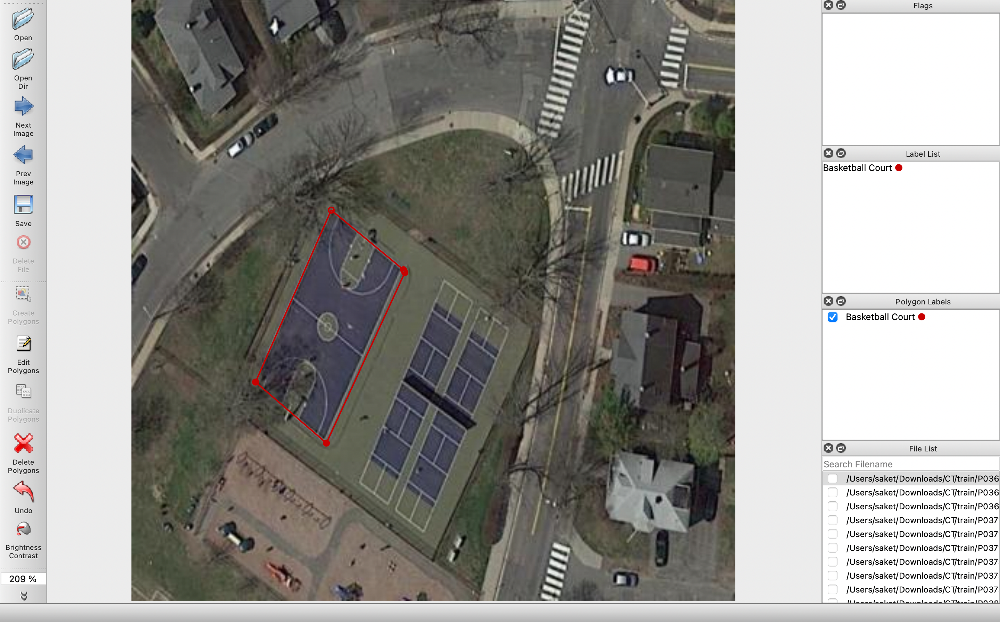

In [ ]:
from IPython.display import Image
Image('/content/drive/MyDrive/Screen Shot 2022-10-22 at 10.50.11 PM.png')

##Augmentation

Since I didn't have as much data as is necessary, I needed to augment the data. To do this I used Roboflow, which allowed me to make augmentations such as Flip, Rotation, Crop, Blur, etc. 

In the end, I was left with around 400 images after augmentation.

##Model

Finally, Once all the data was consolidated, It's time to the build the model.

We can start by importing all necessary libraries.

Since we are working with visual data and object detection, the logical choice would be a CNN, which would allow our model to accurately detect lines and circles, essential attributes of basketball courts

To do this, we can take advantage of Facebook's Detectron2 Library, providing algorithms that specialize in computer vision. 

In [ ]:
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision

In [ ]:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

In [ ]:
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

Once the necessary libraries are imported, we can grab our images from roboflow:

In [ ]:
!curl -L "https://app.roboflow.com/ds/s1YsLOrrKf?key=W81v0RRHBO" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

Setting up Train, Test, and Validation

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")

Visualizing the data we currently have, we can see how the training data is currently labeled

WARNING [10/21 03:14:59 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[10/21 03:14:59 d2.data.datasets.coco]: Loaded 327 images in COCO format from /content/train/_annotations.coco.json


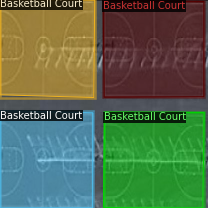

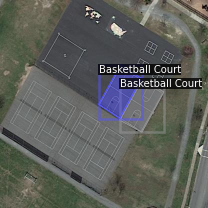

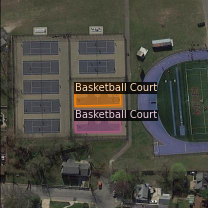

In [ ]:
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

Setting up the COCO evaluator and output location

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

While detectron has its own trainer, I wanted to use Faster RCNN as it will conduct the training quickly and accurately. 

Furthermore, this also lets me choose parameters to fit my specific problem

Thus, I used to following training process:

In [ ]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)
cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml") 
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 1500 
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2 #classes + 1
cfg.TEST.EVAL_PERIOD = 500
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[10/21 03:18:03 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_68b088.pkl: 421MB [00:18, 22.9MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[10/21 03:18:27 d2.engine.train_loop]: Starting training from iteration 0
[10/21 03:19:06 d2.utils.events]:  eta: 0:48:16  iter: 19  total_loss: 2.215  loss_cls: 1.139  loss_box_reg: 0.479  loss_rpn_cls: 0.504  loss_rpn_loc: 0.049  time: 1.9417  data_time: 0.0334  lr: 0.000020  max_mem: 7238M
[10/21 03:19:49 d2.utils.events]:  eta: 0:49:42  iter: 39  total_loss: 1.635  loss_cls: 0.884  loss_box_reg: 0.420  loss_rpn_cls: 0.243  loss_rpn_loc: 0.027  time: 2.0402  data_time: 0.0144  lr: 0.000040  max_mem: 7238M
[10/21 03:20:32 d2.utils.events]:  eta: 0:50:02  iter: 59  total_loss: 1.449  loss_cls: 0.653  loss_box_reg: 0.447  loss_rpn_cls: 0.242  loss_rpn_loc: 0.031  time: 2.0802  data_time: 0.0101  lr: 0.000060  max_mem: 7238M
[10/21 03:21:14 d2.utils.events]:  eta: 0:49:40  iter: 79  total_loss: 1.489  loss_cls: 0.567  loss_box_reg: 0.640  loss_rpn_cls: 0.122  loss_rpn_loc: 0.026  time: 2.0907  data_time: 0.0148  lr: 0.000080  max_mem: 7238M
[10/21 03:21:57 d2.utils.events]:  eta: 0:49:0

We can use tensorboard to visualize the statistics of our algorithm

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

Evaluating performance on the model.

In [ ]:
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join("/content/output/model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [10/21 04:13:04 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[10/21 04:13:04 d2.data.datasets.coco]: Loaded 16 images in COCO format from /content/test/_annotations.coco.json
[10/21 04:13:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[10/21 04:13:04 d2.data.common]: Serialized dataset takes 0.01 MiB
[10/21 04:13:04 d2.evaluation.evaluator]: Start inference on 16 images
[10/21 04:13:07 d2.evaluation.evaluator]: Inference done 11/16. 0.1895 s / img. ETA=0:00:00
[10/21 04:13:08 d2.evaluation.evaluator]: Total inference time: 0:00:02.222626 (0.202057 s / img per device, on 1 devices)
[10/21 04:13:08 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:02 (0.189343 s / img per device, on 1 devices)
[10/21 04:13:08 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[10/21 04:13:08 d2.evaluation.coco_evaluation]: Saving results to ./output/c

OrderedDict([('bbox',
              {'AP': 49.56136631506362,
               'AP50': 69.35331178226264,
               'AP75': 54.97081727877222,
               'APs': 40.4950495049505,
               'APm': 50.44981503644871,
               'APl': 55.089108910891085,
               'AP-courts': nan,
               'AP-Basketball Court': 49.56136631506362})])

In [ ]:
%ls ./output/

coco_instances_results.json                       last_checkpoint
events.out.tfevents.1665880002.5558ba566d39.68.0  metrics.json
instances_predictions.pth                         model_final.pth


In [ ]:
cfg.MODEL.WEIGHTS = os.path.join("/content/output/model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

Finally, lets test our model on real world images in our test set: 

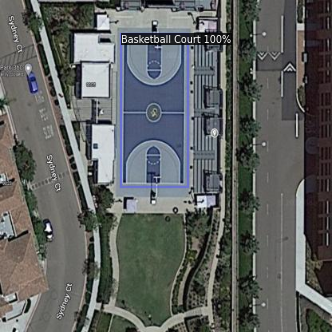

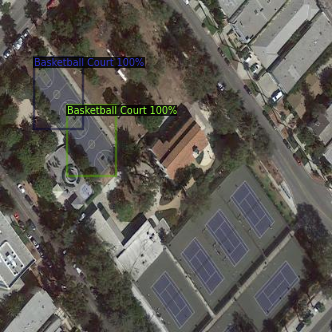

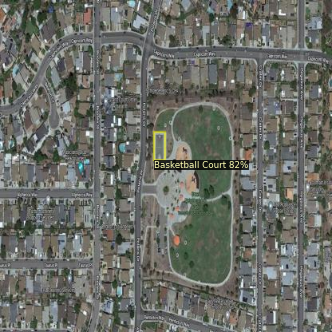

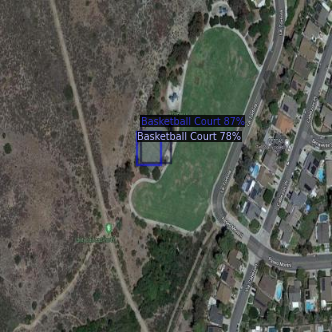

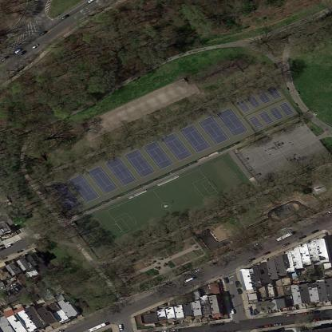

...

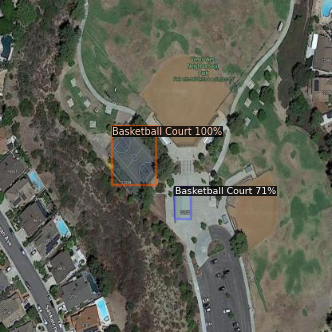

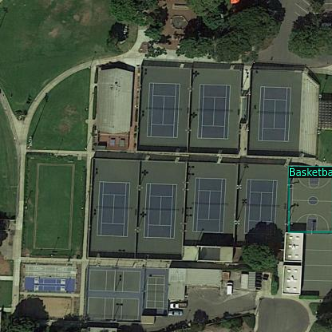

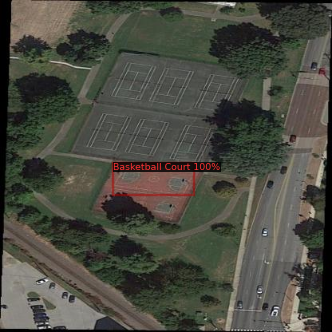

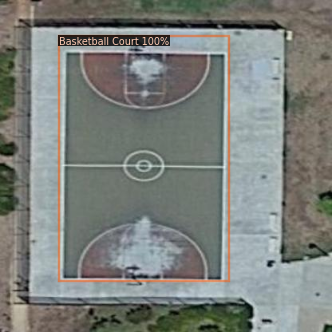

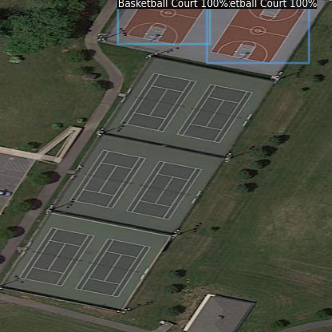

In [ ]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])




We can see from the pictures above, that algorithm is detecting most basketball courts in the dataset quite accurately

##Google Maps

Now comes the problem of applying the algorithm to the real world. 

We can get these satellite images from Google Maps, by accessing the Google Maps API and asking for satellite images at a specific coordinate.

In [ ]:
import requests

In [ ]:
URL_BASE = "https://maps.googleapis.com/maps/api/staticmap?"
API_KEY = "#######################################"
ADDRESS = "32.860606,-117.205375"
ZOOM = "18"


In [ ]:
URL = URL_BASE +  "center=" + ADDRESS+ "&zoom=" + ZOOM + "&size=500x500" + "&maptype=satellite&key=" + API_KEY

In [ ]:
response = requests.get(URL)
with open("renault.png", 'wb') as file:
  file.write(response.content)

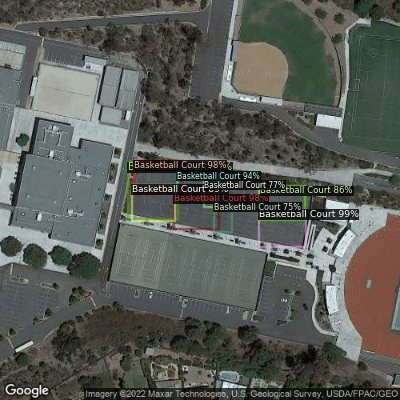

In [ ]:
im = cv2.imread("/content/renault.png")
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
              metadata=test_metadata, 
              scale=0.8
                )
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])


We see above that the model is accurately predicting that there are courts above, albeit over-detecting the courts in view

Lets try asking for a sequence of images, moving left from our original coordinate to see how the model performs:

In [1]:

def coordinate_mapper(initialCoordinate):
  coords = []
  lat = initialCoordinate[0]
  longitude = initialCoordinate[1]
  coords.append(initialCoordinate)
  for i in range(20):
    longitude -= 0.001
    coords.append([lat, longitude])
  return coords


In [2]:
coords = coordinate_mapper([32.860606,-117.205375])

In [ ]:
for i in range(len(coords)):
  ADDRESS = str(coords[i][0]) + "," + str(coords[i][1])
  URL = URL_BASE +  "center=" + ADDRESS+ "&zoom=" + ZOOM + "&size=500x500" + "&maptype=satellite&key=" + API_KEY
  response = requests.get(URL)
  with open("/content/Maps_extraction/loc" + str(i) + ".png", 'wb') as file:
    file.write(response.content)


In [ ]:
URL = URL_BASE +  "center=" + ADDRESS+ "&zoom=" + ZOOM + "&size=500x500" + "&maptype=satellite&key=" + API_KEY

In [ ]:
response = requests.get(URL)
with open("/content/Maps_extraction/loc" + i + ".png", 'wb') as file:
  file.write(response.content)

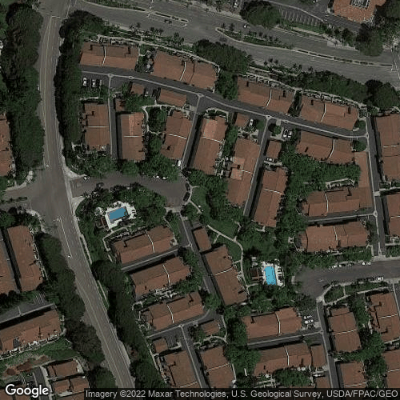

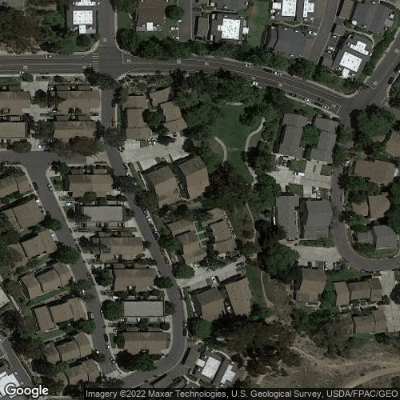

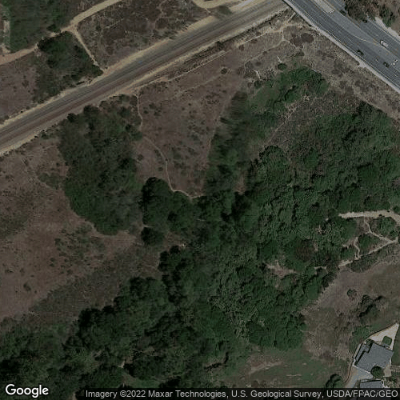

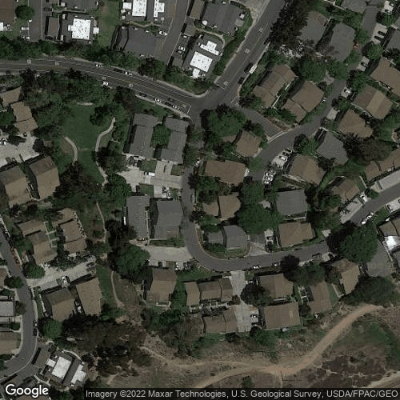

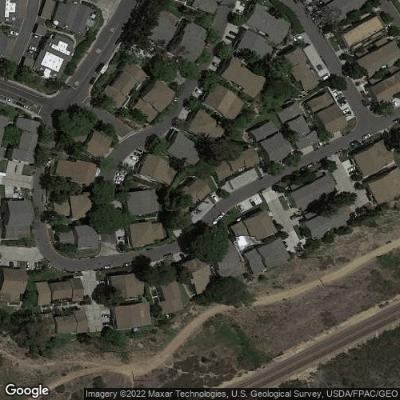

...

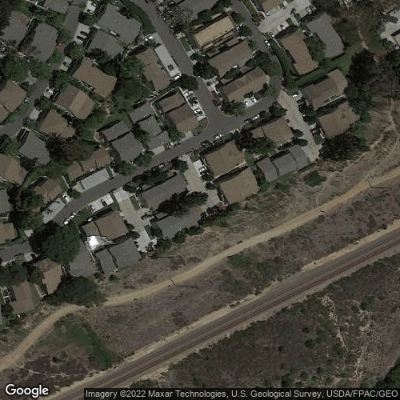

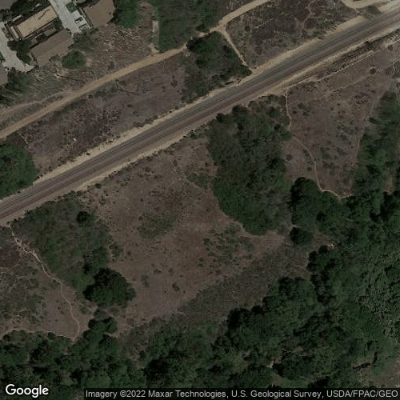

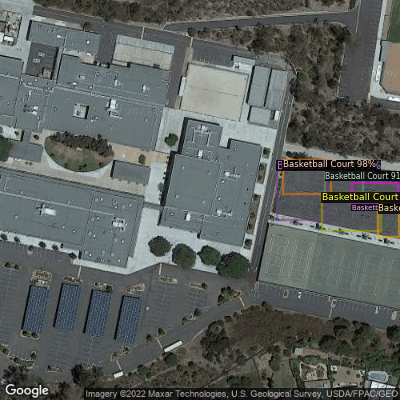

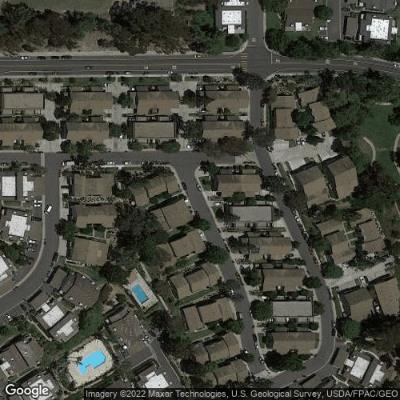

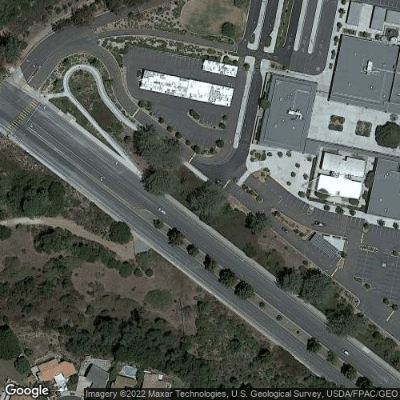

In [ ]:
for imageName in glob.glob('/content/Maps_extraction/*png'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

From the images returned after running the model, we can see that it does indeed find basketball courts.

There is however an issue that it is misdetecting certain road lines as basketball courts

##Next Steps

From the results we have received in this project so far, we can see that the model is indeed accurately detecting all basketball courts we are giving it. 

There are however, a few notable issues:

The model is sometimes mislabeling objects such as roads and buildings as basketball courts

The model is sometimes placing too many labels over basketball courts


Both of these issues most likely stem from the small training dataset we gave model. Ideally, we would have a lot more training data, which would allow the model to more accurately detect these courts and hopefully mitigate the errors we found.


In the final model, we must curate far more data to make the best possible model. This, along with further augmentation should give us enough to create an optimal model.

Furthermore, we must also create an algorithm that effeciently calculates coordinates in a specified radius.

From there we can make calls to the Google Maps API to run the model on all images in the specified radius, displaying courts on a Dynamic Map